In [1]:
import polars as pl
import numpy as np

df = pl.read_csv("../../data/Fraud_Payments/Data/fraud_payment_data/fraud_payment_data")

## Data Loading and Cleaning

In [2]:
df

Time_step,Transaction_Id,Sender_Id,Sender_Account,Sender_Country,Sender_Sector,Sender_lob,Bene_Id,Bene_Account,Bene_Country,USD_amount,Label,Transaction_Type
str,str,str,str,str,i64,str,str,str,str,f64,i64,str
"""2022-03-15 10:24:00""","""EXCHANGE-10115""","""JPMC-CLIENT-10098""","""ACCOUNT-10108""","""USA""",35537,"""CCB""",null,null,null,558.43,0,"""WITHDRAWAL"""
"""2022-03-15 10:24:00""","""QUICK-PAYMENT-10116""","""JPMC-CLIENT-10098""","""ACCOUNT-10109""","""USA""",15287,"""CCB""","""CLIENT-10100""","""ACCOUNT-10106""","""CANADA""",622.78,0,"""QUICK-PAYMENT"""
"""2022-03-15 10:24:00""","""DEPOSIT-CASH-9833""",null,null,null,null,null,"""JPMC-CLIENT-9812""","""ACCOUNT-9826""","""USA""",802.54,0,"""DEPOSIT-CASH"""
"""2022-03-15 10:24:00""","""PAY-CHECK-9832""","""JPMC-CLIENT-9812""","""ACCOUNT-9825""","""USA""",38145,"""CCB""","""JPMC-CLIENT-9814""","""ACCOUNT-9824""","""USA""",989.09,0,"""PAY-CHECK"""
"""2022-03-15 10:24:00""","""DEPOSIT-CHECK-9806""",null,null,null,null,null,"""JPMC-CLIENT-9789""","""ACCOUNT-9800""","""USA""",786.78,0,"""DEPOSIT-CHECK"""
…,…,…,…,…,…,…,…,…,…,…,…,…
"""2054-09-14 13:17:24""","""PAY-BILL-2180018""","""JPMC-CLIENT-2179746""","""ACCOUNT-2179757""","""USA""",24701,"""CCB""","""BILL-COMPANY-2179895""","""ACCOUNT-2179896""","""USA""",159.64,0,"""MAKE-PAYMENT"""
"""2054-09-15 00:57:24""","""QUICK-PAYMENT-2181421""","""JPMC-CLIENT-2181147""","""ACCOUNT-2181158""","""USA""",4953,"""CCB""","""CLIENT-2181279""","""ACCOUNT-2181280""","""USA""",120.07,0,"""QUICK-PAYMENT"""
"""2054-09-15 01:17:24""","""PAYMENT-2180021""","""JPMC-CLIENT-2179746""","""ACCOUNT-2179757""","""USA""",34784,"""CCB""","""BILL-COMPANY-2180022""","""ACCOUNT-2180023""","""USA""",25.32,0,"""MAKE-PAYMENT"""


In [3]:
df = df.with_columns(
    pl.col("Time_step").str.to_datetime(format="%Y-%m-%d %H:%M:%S")
)
df

Time_step,Transaction_Id,Sender_Id,Sender_Account,Sender_Country,Sender_Sector,Sender_lob,Bene_Id,Bene_Account,Bene_Country,USD_amount,Label,Transaction_Type
datetime[μs],str,str,str,str,i64,str,str,str,str,f64,i64,str
2022-03-15 10:24:00,"""EXCHANGE-10115""","""JPMC-CLIENT-10098""","""ACCOUNT-10108""","""USA""",35537,"""CCB""",null,null,null,558.43,0,"""WITHDRAWAL"""
2022-03-15 10:24:00,"""QUICK-PAYMENT-10116""","""JPMC-CLIENT-10098""","""ACCOUNT-10109""","""USA""",15287,"""CCB""","""CLIENT-10100""","""ACCOUNT-10106""","""CANADA""",622.78,0,"""QUICK-PAYMENT"""
2022-03-15 10:24:00,"""DEPOSIT-CASH-9833""",null,null,null,null,null,"""JPMC-CLIENT-9812""","""ACCOUNT-9826""","""USA""",802.54,0,"""DEPOSIT-CASH"""
2022-03-15 10:24:00,"""PAY-CHECK-9832""","""JPMC-CLIENT-9812""","""ACCOUNT-9825""","""USA""",38145,"""CCB""","""JPMC-CLIENT-9814""","""ACCOUNT-9824""","""USA""",989.09,0,"""PAY-CHECK"""
2022-03-15 10:24:00,"""DEPOSIT-CHECK-9806""",null,null,null,null,null,"""JPMC-CLIENT-9789""","""ACCOUNT-9800""","""USA""",786.78,0,"""DEPOSIT-CHECK"""
…,…,…,…,…,…,…,…,…,…,…,…,…
2054-09-14 13:17:24,"""PAY-BILL-2180018""","""JPMC-CLIENT-2179746""","""ACCOUNT-2179757""","""USA""",24701,"""CCB""","""BILL-COMPANY-2179895""","""ACCOUNT-2179896""","""USA""",159.64,0,"""MAKE-PAYMENT"""
2054-09-15 00:57:24,"""QUICK-PAYMENT-2181421""","""JPMC-CLIENT-2181147""","""ACCOUNT-2181158""","""USA""",4953,"""CCB""","""CLIENT-2181279""","""ACCOUNT-2181280""","""USA""",120.07,0,"""QUICK-PAYMENT"""
2054-09-15 01:17:24,"""PAYMENT-2180021""","""JPMC-CLIENT-2179746""","""ACCOUNT-2179757""","""USA""",34784,"""CCB""","""BILL-COMPANY-2180022""","""ACCOUNT-2180023""","""USA""",25.32,0,"""MAKE-PAYMENT"""


In [4]:
df.describe()

statistic,Time_step,Transaction_Id,Sender_Id,Sender_Account,Sender_Country,Sender_Sector,Sender_lob,Bene_Id,Bene_Account,Bene_Country,USD_amount,Label,Transaction_Type
str,str,str,str,str,str,f64,str,str,str,str,f64,f64,str
"""count""","""1498177""","""1498177""","""1279291""","""1279291""","""1279291""",1.279291e6,"""1279291""","""1282284""","""1282284""","""1282284""",1.498177e6,1.498177e6,"""1498177"""
"""null_count""","""0""","""0""","""218886""","""218886""","""218886""",218886.0,"""218886""","""215893""","""215893""","""215893""",0.0,0.0,"""0"""
"""mean""","""2038-06-16 16:05:19.737898""",null,null,null,null,25021.33413,null,null,null,null,513.469777,0.020571,null
"""std""",null,null,null,null,null,14431.714191,null,null,null,null,539.808914,0.141943,null
"""min""","""2022-03-15 10:24:00""","""CASH-CHECK-1000067""","""BILL-COMPANY-100003""","""ACCOUNT-100004""","""AFGHANISTAN""",0.0,"""CCB""","""BILL-COMPANY-100000""","""ACCOUNT-1000001""","""AFGHANISTAN""",0.0,0.0,"""DEPOSIT-CASH"""
"""25%""","""2030-03-29 18:54:50""",null,null,null,null,12534.0,null,null,null,null,138.69,0.0,null
"""50%""","""2038-05-25 09:25:42""",null,null,null,null,25023.0,null,null,null,null,404.16,0.0,null
"""75%""","""2046-08-19 14:06:34""",null,null,null,null,37531.0,null,null,null,null,734.07,0.0,null
"""max""","""2054-09-15 13:07:24""","""WITHDRAWAL-999990""","""JPMC-COMPANY-999648""","""ACCOUNT-999995""","""ZIMBABWE""",49999.0,"""CCB""","""JPMC-COMPANY-999909""","""ACCOUNT-999998""","""ZIMBABWE""",19998.94,1.0,"""WITHDRAWAL"""


In [5]:
df.null_count()

Time_step,Transaction_Id,Sender_Id,Sender_Account,Sender_Country,Sender_Sector,Sender_lob,Bene_Id,Bene_Account,Bene_Country,USD_amount,Label,Transaction_Type
u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32
0,0,218886,218886,218886,218886,218886,215893,215893,215893,0,0,0


In [6]:
# filter out rows with null values
df_nulled = df.filter(pl.col("Sender_Id").is_null())
df_nulled

Time_step,Transaction_Id,Sender_Id,Sender_Account,Sender_Country,Sender_Sector,Sender_lob,Bene_Id,Bene_Account,Bene_Country,USD_amount,Label,Transaction_Type
datetime[μs],str,str,str,str,i64,str,str,str,str,f64,i64,str
2022-03-15 10:24:00,"""DEPOSIT-CASH-9833""",null,null,null,null,null,"""JPMC-CLIENT-9812""","""ACCOUNT-9826""","""USA""",802.54,0,"""DEPOSIT-CASH"""
2022-03-15 10:24:00,"""DEPOSIT-CHECK-9806""",null,null,null,null,null,"""JPMC-CLIENT-9789""","""ACCOUNT-9800""","""USA""",786.78,0,"""DEPOSIT-CHECK"""
2022-03-15 10:24:00,"""DEPOSIT-CASH-9781""",null,null,null,null,null,"""JPMC-CLIENT-9763""","""ACCOUNT-9774""","""USA""",792.19,0,"""DEPOSIT-CASH"""
2022-03-15 10:24:00,"""DEPOSIT-CHECK-9504""",null,null,null,null,null,"""JPMC-CLIENT-9483""","""ACCOUNT-9494""","""USA""",942.83,0,"""DEPOSIT-CHECK"""
2022-03-15 10:24:00,"""QUICK-DEPOSIT-8756""",null,null,null,null,null,"""JPMC-CLIENT-8736""","""ACCOUNT-8747""","""USA""",469.41,0,"""DEPOSIT-CASH"""
…,…,…,…,…,…,…,…,…,…,…,…,…
2054-09-13 00:37:24,"""DEPOSIT-CHECK-2180011""",null,null,null,null,null,"""JPMC-CLIENT-2179746""","""ACCOUNT-2179824""","""USA""",425.67,0,"""DEPOSIT-CHECK"""
2054-09-13 12:37:24,"""QUICK-DEPOSIT-2180012""",null,null,null,null,null,"""JPMC-CLIENT-2179746""","""ACCOUNT-2179756""","""USA""",706.06,0,"""DEPOSIT-CASH"""
2054-09-13 13:47:24,"""DEPOSIT-CHECK-2185479""",null,null,null,null,null,"""JPMC-CLIENT-2185194""","""ACCOUNT-2185210""","""USA""",379.88,0,"""DEPOSIT-CHECK"""


In [7]:
# visualize outliers for time step column (horizontal violin plot)
import plotly.graph_objects as go

fig = go.Figure()
fig.add_trace(go.Violin(x=df["USD_amount"].to_numpy(), box_visible=True, line_color='black', meanline_visible=True, fillcolor='lightseagreen', opacity=0.6, name='Time_step'))
fig.show()

In [8]:
for col in df.columns:
    print(col)
    print(df[col].value_counts())

Time_step
shape: (639_300, 2)
┌─────────────────────┬───────┐
│ Time_step           ┆ count │
│ ---                 ┆ ---   │
│ datetime[μs]        ┆ u32   │
╞═════════════════════╪═══════╡
│ 2030-03-12 15:14:50 ┆ 1     │
│ 2044-10-11 01:16:22 ┆ 2     │
│ 2027-11-11 10:14:35 ┆ 1     │
│ 2033-07-03 05:45:11 ┆ 2     │
│ 2047-01-18 20:56:36 ┆ 1     │
│ …                   ┆ …     │
│ 2031-10-21 22:05:00 ┆ 1     │
│ 2040-12-22 02:15:58 ┆ 3     │
│ 2053-12-29 12:37:20 ┆ 2     │
│ 2044-12-08 05:06:23 ┆ 1     │
│ 2026-04-25 20:24:25 ┆ 1     │
└─────────────────────┴───────┘
Transaction_Id
shape: (1_498_177, 2)
┌───────────────────────┬───────┐
│ Transaction_Id        ┆ count │
│ ---                   ┆ ---   │
│ str                   ┆ u32   │
╞═══════════════════════╪═══════╡
│ DEPOSIT-CHECK-1098825 ┆ 1     │
│ QUICK-PAYMENT-165216  ┆ 1     │
│ PAYMENT-370145        ┆ 1     │
│ MOVE-FUNDS-16226      ┆ 1     │
│ PAYMENT-1761283       ┆ 1     │
│ …                     ┆ …     │
│ MOVE-FUNDS-12

- For the sake of training the model, I am taking label to be the 'target' column and the rest of the columns as features. I will be using the 'target' column to train the model and predict the values of the 'target' column for the test data.

In [9]:
df_fraudulent = df.filter(pl.col("Label") == 1)

In [10]:
df_fraudulent

Time_step,Transaction_Id,Sender_Id,Sender_Account,Sender_Country,Sender_Sector,Sender_lob,Bene_Id,Bene_Account,Bene_Country,USD_amount,Label,Transaction_Type
datetime[μs],str,str,str,str,i64,str,str,str,str,f64,i64,str
2022-03-15 10:24:00,"""QUICK-PAYMENT-8964""","""JPMC-CLIENT-8947""","""ACCOUNT-8957""","""USA""",23505,"""CCB""","""CLIENT-8965""","""ACCOUNT-8966""","""BENIN""",857.13,1,"""QUICK-PAYMENT"""
2022-03-15 22:54:00,"""DEPOSIT-CASH-2517""",null,null,null,null,null,"""JPMC-CLIENT-2492""","""ACCOUNT-2502""","""USA""",684.52,1,"""DEPOSIT-CASH"""
2022-03-15 23:04:00,"""PAY-BILL-2521""","""JPMC-CLIENT-2492""","""ACCOUNT-2503""","""USA""",6909,"""CCB""","""JPMC-COMPANY-2495""","""ACCOUNT-2501""","""USA""",787.8,1,"""MAKE-PAYMENT"""
2022-03-15 23:14:00,"""WITHDRAWAL-2519""","""JPMC-CLIENT-2492""","""ACCOUNT-2502""","""USA""",46666,"""CCB""",null,null,null,194.67,1,"""WITHDRAWAL"""
2022-03-16 11:14:00,"""MOVE-FUNDS-2522""","""JPMC-CLIENT-2492""","""ACCOUNT-2503""","""USA""",6337,"""CCB""","""JPMC-COMPANY-2494""","""ACCOUNT-2500""","""ALAND-ISLANDS""",812.27,1,"""MOVE-FUNDS"""
…,…,…,…,…,…,…,…,…,…,…,…,…
2054-09-03 15:57:24,"""PAY-BILL-2176469""","""JPMC-CLIENT-2176199""","""ACCOUNT-2176209""","""USA""",32806,"""CCB""","""BILL-COMPANY-2176271""","""ACCOUNT-2176272""","""USA""",551.12,1,"""MAKE-PAYMENT"""
2054-09-09 01:27:24,"""QUICK-PAYMENT-2184316""","""BILL-COMPANY-2184254""","""ACCOUNT-2184255""","""MALTA""",25754,"""CCB""","""JPMC-CLIENT-2184056""","""ACCOUNT-2184137""","""USA""",646.79,1,"""QUICK-PAYMENT"""
2054-09-09 14:07:24,"""WITHDRAWAL-2184327""","""JPMC-CLIENT-2184056""","""ACCOUNT-2184137""","""USA""",46304,"""CCB""",null,null,null,800.69,1,"""EXCHANGE"""


In [11]:
# EDA of fraudulent transactions
df_fraudulent[['USD_amount']].describe()

statistic,USD_amount
str,f64
"""count""",30819.0
"""null_count""",0.0
"""mean""",847.442043
"""std""",2003.566402
"""min""",100.0
"""25%""",254.15
"""50%""",512.23
"""75%""",773.98
"""max""",19998.94


In [12]:
df[['USD_amount']].describe()

statistic,USD_amount
str,f64
"""count""",1.498177e6
"""null_count""",0.0
"""mean""",513.469777
"""std""",539.808914
"""min""",0.0
"""25%""",138.69
"""50%""",404.16
"""75%""",734.07
"""max""",19998.94


<Axes: ylabel='Count'>

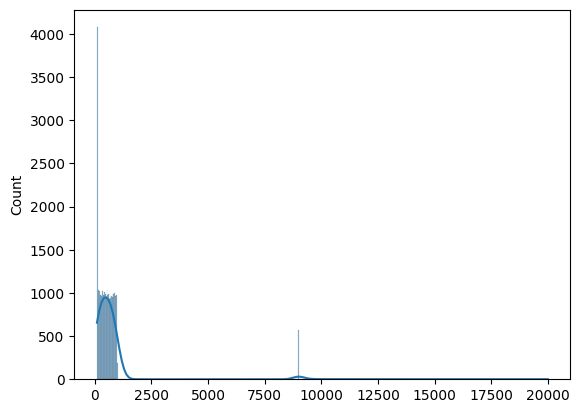

In [13]:
# add histogram of fraudulent transactions
import seaborn as sns
import matplotlib.pyplot as plt

sns.histplot(df_fraudulent['USD_amount'].to_numpy(), kde=True)

In [14]:
# pie chart of fraudulent transactions to non-fraudulent transactions
fraudulent_count = df_fraudulent.shape[0]
total_count = df.shape[0]
non_fraudulent_count = total_count - fraudulent_count

fig = go.Figure(data=[go.Pie(labels=['Fraudulent', 'Non-Fraudulent'], values=[fraudulent_count, non_fraudulent_count])])
fig.show()

In [15]:
df.to_pandas()

,Time_step,Transaction_Id,Sender_Id,Sender_Account,Sender_Country,Sender_Sector,Sender_lob,Bene_Id,Bene_Account,Bene_Country,USD_amount,Label,Transaction_Type
0,2022-03-15 10:24:00,EXCHANGE-10115,JPMC-CLIENT-10098,ACCOUNT-10108,USA,35537.0,CCB,None,None,None,558.43,0,WITHDRAWAL
1,2022-03-15 10:24:00,QUICK-PAYMENT-10116,JPMC-CLIENT-10098,ACCOUNT-10109,USA,15287.0,CCB,CLIENT-10100,ACCOUNT-10106,CANADA,622.78,0,QUICK-PAYMENT
2,2022-03-15 10:24:00,DEPOSIT-CASH-9833,None,None,None,NaN,None,JPMC-CLIENT-9812,ACCOUNT-9826,USA,802.54,0,DEPOSIT-CASH
3,2022-03-15 10:24:00,PAY-CHECK-9832,JPMC-CLIENT-9812,ACCOUNT-9825,USA,38145.0,CCB,JPMC-CLIENT-9814,ACCOUNT-9824,USA,989.09,0,PAY-CHECK
4,2022-03-15 10:24:00,DEPOSIT-CHECK-9806,None,None,None,NaN,None,JPMC-CLIENT-9789,ACCOUNT-9800,USA,786.78,0,DEPOSIT-CHECK
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1498172,2054-09-14 13:17:24,PAY-BILL-2180018,JPMC-CLIENT-2179746,ACCOUNT-2179757,USA,24701.0,CCB,BILL-COMPANY-2179895,ACCOUNT-2179896,USA,159.64,0,MAKE-PAYMENT
1498173,2054-09-15 00:57:24,QUICK-PAYMENT-2181421,JPMC-CLIENT-2181147,ACCOUNT-2181158,USA,4953.0,CCB,CLIENT-2181279,ACCOUNT-2181280,USA,120.07,0,QUICK-PAYMENT
1498174,2054-09-15 01:17:24,PAYMENT-2180021,JPMC-CLIENT-2179746,ACCOUNT-2179757,USA,34784.0,CCB,BILL-COMPANY-2180022,ACCOUNT-2180023,USA,25.32,0,MAKE-PAYMENT
1498175,2054-09-15 12:57:24,QUICK-PAYMENT-2181422,JPMC-CLIENT-2181147,ACCOUNT-2181158,USA,23822.0,CCB,CLIENT-2181279,ACCOUNT-2181280,USA,610.91,0,QUICK-PAYMENT


In [22]:
# convert categorical columns to numerical values
import pandas as pd
dfp = df.to_pandas()

dfp['Transaction_Id'] = pd.factorize(dfp['Transaction_Id'])[0]
dfp['Sender_Id'] = pd.factorize(dfp['Sender_Id'])[0]
dfp['Sender_Account'] = pd.factorize(dfp['Sender_Account'])[0]
dfp['Sender_Country'] = pd.factorize(dfp['Sender_Country'])[0]
dfp['Sender_Sector'] = pd.factorize(dfp['Sender_Sector'])[0]
dfp['Sender_lob'] = pd.factorize(dfp['Sender_lob'])[0]
dfp['Bene_Id'] = pd.factorize(dfp['Bene_Id'])[0]
dfp['Bene_Account'] = pd.factorize(dfp['Bene_Account'])[0]
dfp['Bene_Country'] = pd.factorize(dfp['Bene_Country'])[0]
dfp['Transaction_Type'] = pd.factorize(dfp['Transaction_Type'])[0]

# calculate correlation matrix
dfp.corr()

,Time_step,Transaction_Id,Sender_Id,Sender_Account,Sender_Country,Sender_Sector,Sender_lob,Bene_Id,Bene_Account,Bene_Country,USD_amount,Label,Transaction_Type
Time_step,1.000000,0.999989,0.771429,0.771080,0.005887,0.042890,-0.000823,0.773347,0.773253,0.003659,-0.000221,-0.002143,-0.000062
Transaction_Id,0.999989,1.000000,0.771435,0.771087,0.005964,0.043012,-0.000813,0.773359,0.773266,0.003686,-0.000232,-0.002140,-0.000041
Sender_Id,0.771429,0.771435,1.000000,0.999996,0.085291,0.340173,0.549939,0.528656,0.528385,0.063406,-0.006208,0.001349,0.097211
Sender_Account,0.771080,0.771087,0.999996,1.000000,0.086228,0.340479,0.550510,0.528276,0.528003,0.063566,-0.006434,0.001344,0.097331
Sender_Country,0.005887,0.005964,0.085291,0.086228,1.000000,0.082905,0.145205,0.012556,0.012583,-0.008155,-0.005085,0.008192,-0.006429
Sender_Sector,0.042890,0.043012,0.340173,0.340479,0.082905,1.000000,0.547302,-0.017607,-0.017810,0.061815,-0.005611,0.002992,0.096820
Sender_lob,-0.000823,-0.000813,0.549939,0.550510,0.145205,0.547302,1.000000,-0.092986,-0.093349,0.111298,-0.012089,0.005082,0.176823
Bene_Id,0.773347,0.773359,0.528656,0.528276,0.012556,-0.017607,-0.092986,1.000000,0.999999,0.119291,-0.000188,-0.006394,0.042645
Bene_Account,0.773253,0.773266,0.528385,0.528003,0.012583,-0.017810,-0.093349,0.999999,1.000000,0.119389,-0.000001,-0.006395,0.042605
Bene_Country,0.003659,0.003686,0.063406,0.063566,-0.008155,0.061815,0.111298,0.119291,0.119389,1.000000,-0.089138,-0.000118,0.056952


In [26]:
# visualize correlation matrix with plotly
fig = go.Figure(data=go.Heatmap(
                     z=dfp.corr(),
                     x=dfp.columns,
                     y=dfp.columns))
fig.show()

In [28]:
# visualize correlation matrix for the label column with plotly
label_column = 'Label'  # replace with the actual name of your label column
correlations = dfp.corr()[label_column].sort_values(ascending=False)

fig = go.Figure(data=go.Heatmap(
                     z=[correlations.values],
                     x=correlations.index,
                     y=[label_column],
                     colorscale='Viridis'))
fig.update_layout(
    title=f'Correlation of {label_column} with other features',
    xaxis_title='Features',
    yaxis_title=label_column
)
fig.show()

## Create a baseline model

In [33]:
from sklearn.model_selection import train_test_split

X = dfp.drop(columns=['Label', 'Time_step'])
y = dfp['Label']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [35]:
# from sklearn.preprocessing import LabelEncoder
from sklearn.linear_model import LogisticRegression
from sklearn.preprocessing import StandardScaler

# Convert datetime column to numerical representation
# le = LabelEncoder()
# X_train['Time_step'] = le.fit_transform(X_train['Time_step'])
X_train_scaled = StandardScaler().fit_transform(X_train)

# Create and fit the logistic regression model
model = LogisticRegression(max_iter=2000, C=0.1)
model.fit(X_train_scaled, y_train)

LogisticRegression(C=0.1, max_iter=2000)

In [36]:
X_train

,Transaction_Id,Sender_Id,Sender_Account,Sender_Country,Sender_Sector,Sender_lob,Bene_Id,Bene_Account,Bene_Country,USD_amount,Transaction_Type
781636,781636,30568,39204,24,2354,0,145738,153943,1,73.82,5
598269,598269,-1,-1,-1,-1,-1,110518,116909,1,214.77,4
545830,545830,21330,27143,5,44034,0,101001,106908,1,209.92,1
358264,358264,-1,-1,-1,-1,-1,66168,70042,1,100.03,4
1323802,1323802,52067,66269,0,27487,0,246606,260478,153,372.72,6
...,...,...,...,...,...,...,...,...,...,...,...
259178,259178,10074,12823,0,14988,0,-1,-1,-1,105.18,7
1414414,1414414,-1,-1,-1,-1,-1,263011,277768,1,104.39,2
131932,131932,4921,6537,0,25265,0,23325,24626,1,823.29,6
671155,671155,26336,33529,0,28318,0,124193,131358,1,427.54,1


In [38]:
# evaluate the model
from sklearn.metrics import classification_report

X_test_scaled = StandardScaler().fit_transform(X_test)
y_pred = model.predict(X_test_scaled)

print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.98      1.00      0.99    293559
           1       0.91      0.02      0.04      6077

    accuracy                           0.98    299636
   macro avg       0.95      0.51      0.52    299636
weighted avg       0.98      0.98      0.97    299636



The metrics indicate excellent performance on the majority class (non-fraudulent transactions) but very low recall and F1-score for the minority class (fraudulent transactions). This is a typical issue in highly imbalanced datasets, as the model primarily learns to classify the majority class correctly, neglecting the minority class.

### Adjusting the class weights

Assigning a higher weight to the minority class can help the model pay more attention to it. This can be done by setting class_weight='balanced' in LogisticRegression, which automatically assigns weights inversely proportional to class frequencies.

In [40]:
model_class_weighted = LogisticRegression(max_iter=2000, C=0.1, class_weight='balanced')
model_class_weighted.fit(X_train_scaled, y_train)

LogisticRegression(C=0.1, class_weight='balanced', max_iter=2000)

In [41]:
y_pred_class_weighted = model_class_weighted.predict(X_test_scaled)

print(classification_report(y_test, y_pred_class_weighted))

              precision    recall  f1-score   support

           0       0.98      0.65      0.79    293559
           1       0.03      0.47      0.05      6077

    accuracy                           0.65    299636
   macro avg       0.51      0.56      0.42    299636
weighted avg       0.96      0.65      0.77    299636



<Axes: >

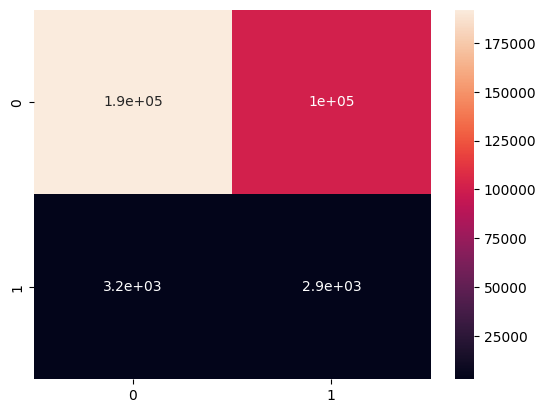

In [44]:
# plot confusion matrix
from sklearn.metrics import confusion_matrix
import seaborn as sns

cm = confusion_matrix(y_test, y_pred_class_weighted)
sns.heatmap(cm, annot=True)

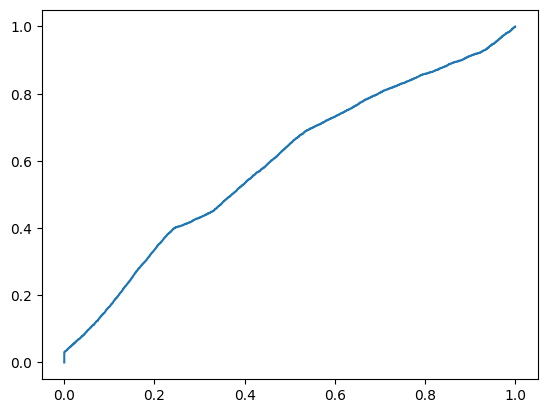

In [45]:
# plot ROC curve
from sklearn.metrics import roc_curve, roc_auc_score
import matplotlib.pyplot as plt

y_pred_proba = model_class_weighted.predict_proba(X_test_scaled)[:, 1]
fpr, tpr, _ = roc_curve(y_test, y_pred_proba)

plt.plot(fpr, tpr)